## T Cell scVI Integration <a class="tocSkip">

Loads unintegrated T cell anndata and marker gene dictionary, runs scVI integration, saves latent representation and normalized expression, and saves VAE and updated anndata. Finally, visualizes integrated T cell output, including marker genes.

Author: Kevin Hoffer-Hawlik

## Setup

In [12]:
import warnings
# warnings.simplefilter(action='ignore',)
# warnings.simplefilter(action='ignore', category=FutureWarning)
# warnings.simplefilter(action='ignore', category=ResourceWarning)

import pandas as pd
import numpy as np
import scanpy as sc
import matplotlib.pyplot as plt
import scvi
import seaborn as sns
import scipy.stats
import scib
import pickle

warnings.simplefilter(action='ignore',)
warnings.simplefilter(action='ignore',)

In [5]:
def calculate_mean_expression(ad, marker_genes, gene_set, layer = None):
    """
    Creates obs column with gene_set as name, containing mean expression and z scores
    for a given gene set for each cell
    """
    genes = marker_genes[gene_set] # set list of genes of interest
    
    # create dataframe to index
    if layer == None: # in case unintegrated logarithmized counts aren't saved as layer
        ad_df = pd.DataFrame(ad.X.todense())
    else:
        ad_df = pd.DataFrame(ad.layers[layer])
    ad_df.columns = ad.var_names
    
    array = ad_df.loc[:,genes].to_numpy() # recover array of expression values for each gene of interest
    means = np.mean(array, axis = 1) # take row average
    z_scores = scipy.stats.zscore(means) # calculate z scores across each row
    
    if layer == None:
        key = gene_set + "_mean_expression"
    else:
        key = gene_set + "_mean_expression_" + layer
    ad.obs[key] = means # save mean expression value for each cell in obs of anndata
    
    if layer == None:
        key = gene_set + "_z_score"
    else:
        key = gene_set + "_z_score_" + layer
    ad.obs[key] = z_scores # save z scores for each cell in obs of anndata
    
    
def calculate_mean_expression_signed(ad, marker_genes, gene_set, layer = None):
    """
    Similar to above function, but calculate mean expression and z scores for a given
    gene set for each cell, assuming the gene_set has signed genes ("+" or "-" at end)
    """
    genes = marker_genes[gene_set] # set list of genes of interest
    
    # create dataframe to index
    if layer == None: # in case unintegrated logarithmized counts aren't saved as layer
        ad_df = pd.DataFrame(ad.X.todense())
    else:
        ad_df = pd.DataFrame(ad.layers[layer])
    ad_df.columns = ad.var_names
    
    # create list to track positive and negative genes, and strip +/- from gene name
    pos = []
    neg = []
    for gene in genes:
        if gene[-1] == '+':
            unsigned = gene.split('+')[0]
            pos.append(unsigned)
        else:
            unsigned = gene.split('-')[0]
            neg.append(unsigned)

    # recover array of expression values for each positive and negative gene of interest
    pos_array = ad_df.loc[:,pos].to_numpy() # keep the sign
    neg_array = -ad_df.loc[:,neg].to_numpy() # flip the sign
    array = np.concatenate((pos_array,neg_array), axis=1) # join columns (genes)
    
    means = np.mean(array, axis = 1) # take row average
    z_scores = scipy.stats.zscore(means) # calculate z scores across each row
    
    if layer == None:
        key = gene_set + "_mean_expression"
    else:
        key = gene_set + "_mean_expression_" + layer
    ad.obs[key] = means # save mean expression value for each cell in obs of anndata
    
    if layer == None:
        key = gene_set + "_z_score"
    else:
        key = gene_set + "_z_score_" + layer
    ad.obs[key] = z_scores # save z scores for each cell in obs of anndata

## Load Data

In [6]:
tcell_filepath = 'tcells_unintegrated_030823.h5ad'
marker_genes_filepath = 'marker_genes_dict_030823.pickle'

tcells_scvi = sc.read_h5ad(tcell_filepath)
tcells_scvi

AnnData object with n_obs × n_vars = 23658 × 8170
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'percent.rps', 'percent.rpl', 'percent.rp', 'sample', 'patient', 'condition', 'barcode_orig', 'barcode_pat', 'samples_per_patient', 'timepoint', 'Before.During.After', 'Sample_J', 'Gender', 'Treatment_phase', 'Drug', 'tissue', 'Mutation', 'sample_group', 'predicted_doublets', 'doublet_scores', 'RNA_snn_res.0.8', 'seurat_clusters', 'clonotype_id', 'chain', 'v_gene', 'd_gene', 'j_gene', 'c_gene', 'frequency', 'proportion', 'cdr3s_aa', 'cdr3s_nt', 'inkt_evidence', 'mait_evidence', 'tcr', 'mait', 'inkt', 'both_chains', 'clone_size', 'mait_inkt', 'celltype_bped_main', 'celltype_bped_fine', 'celltype_hpca_main', 'celltype_hpca_fine', 'immune', 'has_cnv_chr1', 'has_loss_chr1', 'has_dupli_chr1', 'proportion_cnv_chr1', 'proportion_loss_chr1', 'proportion_dupli_chr1', 'proportion_scaled_cnv_chr1', 'proportion_scaled_loss_chr1', 'proportion_scaled_dupli_chr1', 'has_cnv_chr2', 'has_

In [7]:
# load marker genes dictionary
with open(marker_genes_filepath, 'rb') as handle:
    marker_genes = pickle.load(handle)
marker_genes.keys()

dict_keys(['lineage_markers', 'naive_markers', 'memory_markers', 'exhaustion_markers', 'activation_markers', 'effector_cytokines', 'transcription_factors', 'self-renewal/memory markers', 'NK/gd T cell genes', 'Th17', 'Treg', 'Tfh', 'Th22', 'Th9', 'Pro_inflammatory', 'Cytolytics_effector_pathway', 'CD8_T_cell_activation', 'Type_I_interferon_response', 'Type_II_interferon_response', 'Exhaustion/Terminal_differentiation', 'CD8_deletional_tolerance', 'CD8_TIL_dysfunction', 'G2/M', 'G1/S', 'Glycogen_metabolism', 'Hypoxia/HIF_regulated', 'CD4_T _cell_anergy', 'CD8_peripheral_tolerance', 'Anti-inflammatory', 'TCA_cycle', 'Pentose_phosphate_pathway', 'Senescence', 'Adenosine_pathway', 'Glucose_deprivation', 'T_cell_co-inhibitory_receptors', 'Effector_cell_cytotoxicity', 'Terminal_exhaustion', 'Precursor_exhaustion', 'T_naive', 'T_stem_central_memory', 'T_central_memory', 'T_effector_memory', 'T_terminal_effector'])

## Perform scVI batch correction

In [8]:
# setup anndata for scVI model training
scvi.model.SCVI.setup_anndata(tcells_scvi, layer = "counts", batch_key = "patient")

/home/kh3205/anaconda3/envs/scvi-scib/lib/python3.10/site-packages/scvi/data/_utils.py:114: UserWarning: Training will be faster when sparse matrix is formatted as CSR. It is safe to cast before model initialization.
  warnings.warn(


In [9]:
# create model (default with two hidden layers for encoder/decoder NNs and latent dimensionality of 30)
vae = scvi.model.SCVI(tcells_scvi, n_layers=2, n_latent=30)
vae.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Epoch 338/338: 100%|█| 338/338 [53:53<00:00,  9.55s/it, loss=1.32e+03, v_

`Trainer.fit` stopped: `max_epochs=338` reached.


Epoch 338/338: 100%|█| 338/338 [53:53<00:00,  9.57s/it, loss=1.32e+03, v_


In [10]:
tcells_scvi.obsm["X_scVI"] = vae.get_latent_representation()

In [11]:
# finish batch normalization and save normalized counts
# first, create list of normalized expression levels for each batch
batch_norm = []
for id_ in np.unique(tcells_scvi.obs["patient"]):
    batch_norm.append(vae.get_normalized_expression(transform_batch=id_))
    
# then, to create normalized expression layer, can just create np using one of the batches, randomly chosen
batch_norm_np = batch_norm[np.random.randint(len(batch_norm))]
batch_norm_np = np.asarray(batch_norm_np)
tcells_scvi.layers["scvi_normalized"]=batch_norm_np

In [13]:
vae.save("scvi_models/tcells_scvi_model_030823.weights", overwrite=False, save_anndata=True) # save model weights + anndata
tcells_scvi.write("tcells_scvi_030823.h5ad") #, compression="gzip") # save scVI output anndata file

## Embed UMAP and visualize integrated T cell data

In [ ]:
# vae = scvi.model.SCVI.load("scvi_models/tcells_scvi_model_030823.weights")
tcells_scvi = sc.read_h5ad("tcells_scvi_030823.h5ad")
# tcells_scvi

In [11]:
# calculate new neighborhood graph and UMAP dim reduction (after batch correction)
sc.pp.neighbors(tcells_scvi, use_rep="X_scVI", n_neighbors = 20)
sc.tl.umap(tcells_scvi)

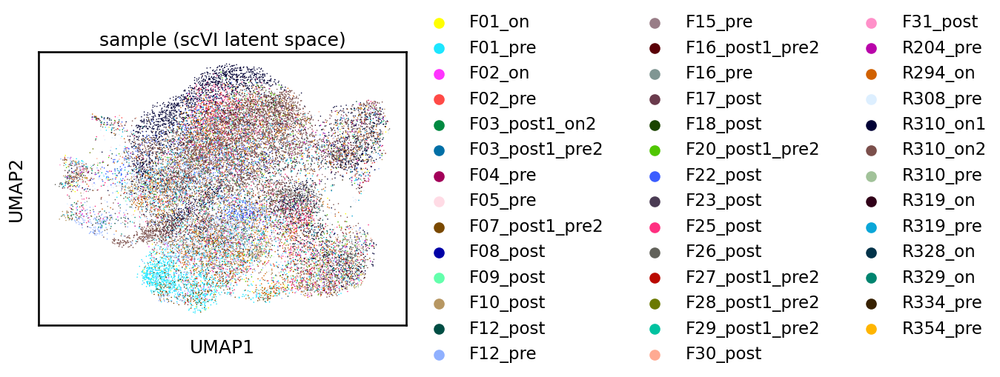

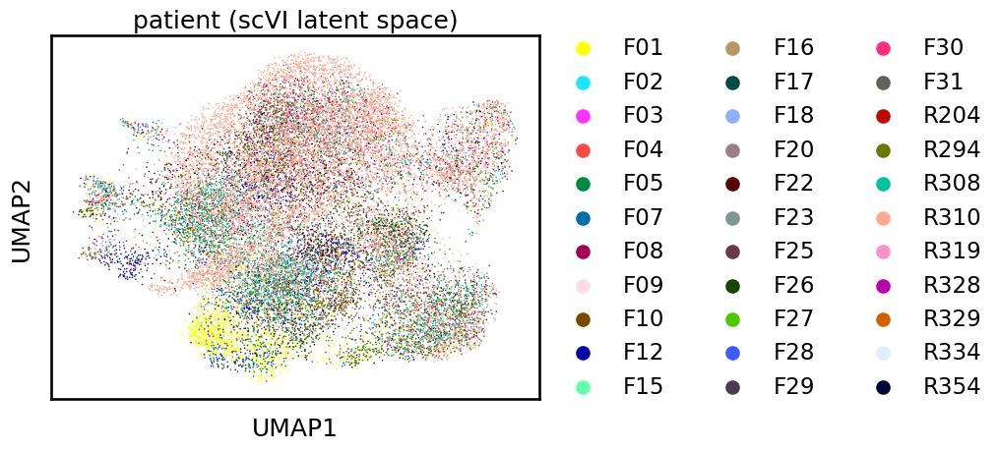

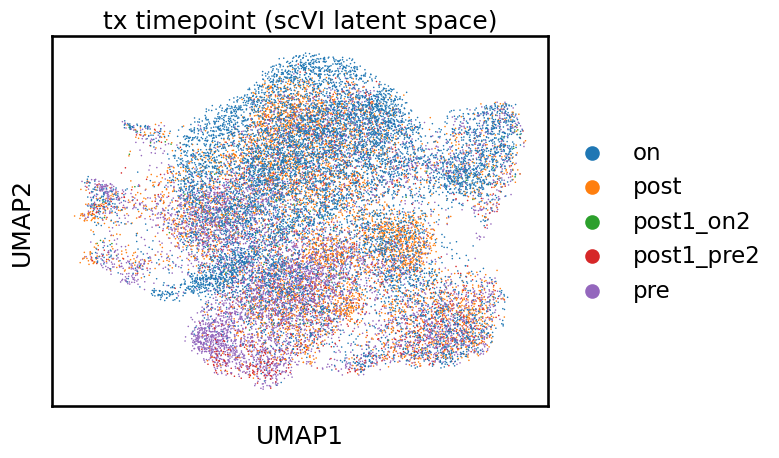

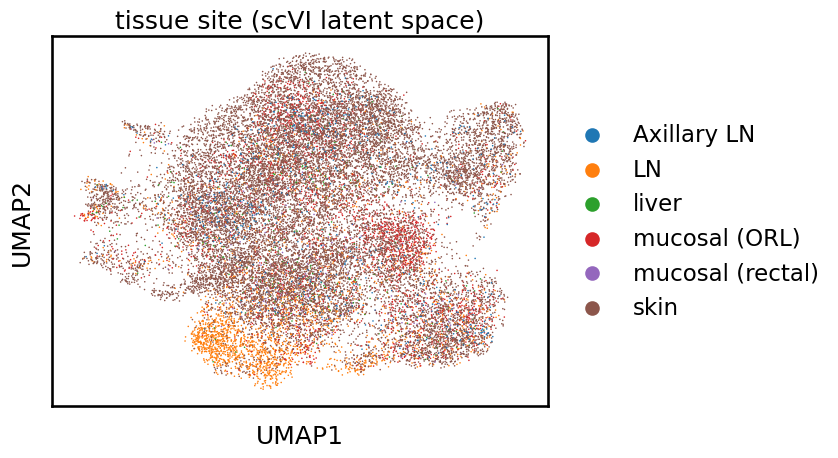

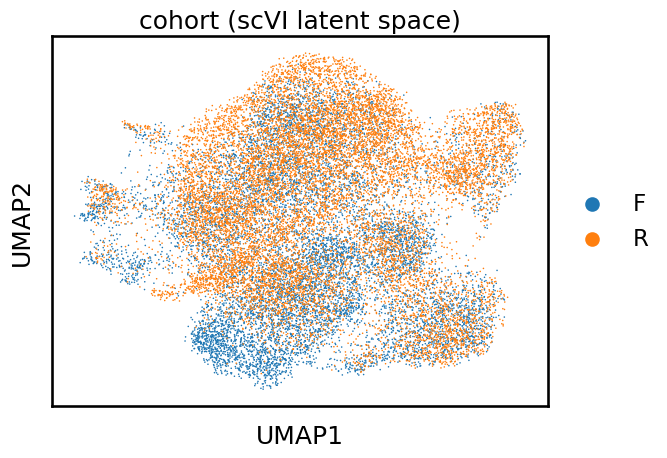

...

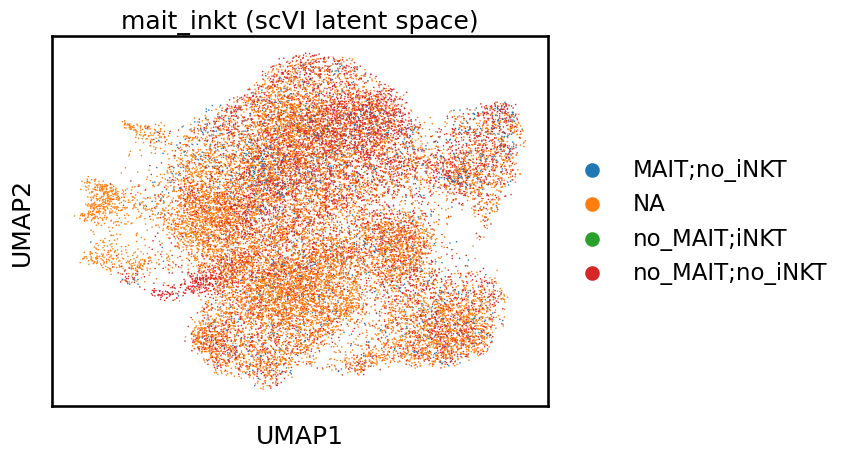

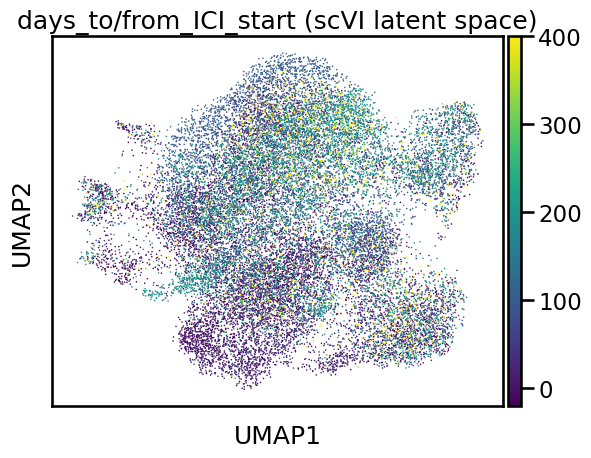

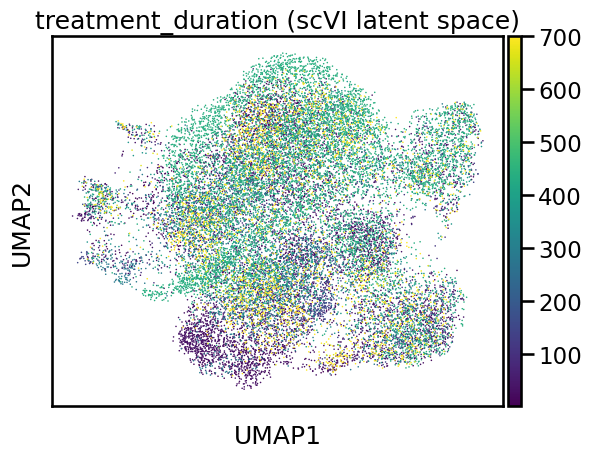

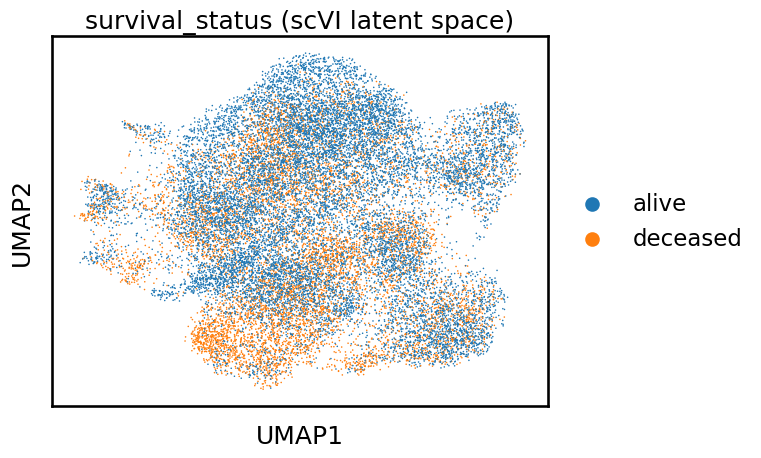

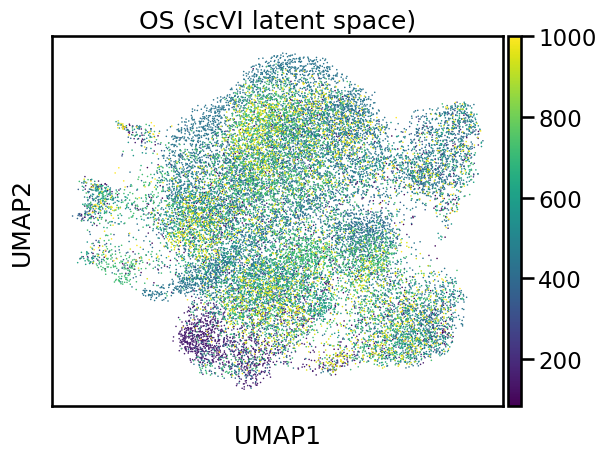

In [ ]:
sc.pl.umap(tcells_scvi, color=["sample"], title='sample (scVI latent space)')
sc.pl.umap(tcells_scvi, color=["patient"], title="patient (scVI latent space)")
sc.pl.umap(tcells_scvi, color=["timepoint"], title='tx timepoint (scVI latent space)')
sc.pl.umap(tcells_scvi, color=["tissue"], title='tissue site (scVI latent space)')
sc.pl.umap(tcells_scvi, color=["cohort"], title='cohort (scVI latent space)')
sc.pl.umap(tcells_scvi, color=["cell_type_fine"], title='Jana annotation (scVI latent space)')
sc.pl.umap(tcells_scvi, color=["Drug"], title='drug (scVI latent space)')
sc.pl.umap(tcells_scvi, color=["clone_size"], title='clone_size (scVI latent space)')
sc.pl.umap(tcells_scvi, color=["mait_inkt"], title='mait_inkt (scVI latent space)')
sc.pl.umap(tcells_scvi, color=["days_to/from_ICI_start"], title='days_to/from_ICI_start (scVI latent space)',
          vmin = -20, vmax = 400)
sc.pl.umap(tcells_scvi, color=["treatment_duration"], title='treatment_duration (scVI latent space)',
          vmax = 700)
sc.pl.umap(tcells_scvi, color=["survival_status"], title='survival_status (scVI latent space)')
sc.pl.umap(tcells_scvi, color=["OS"], title='OS (scVI latent space)', 
          vmax = 1000)

/home/kh3205/anaconda3/envs/scvi-scib/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/kh3205/anaconda3/envs/scvi-scib/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


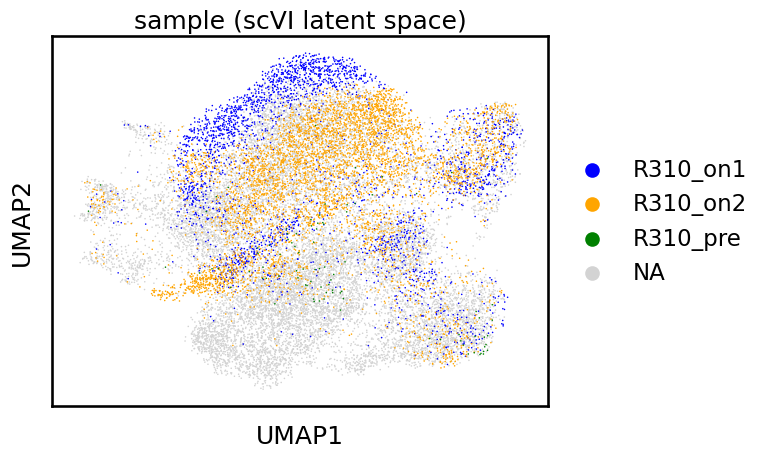

In [18]:
# just color for R310 data
sc.pl.umap(tcells_scvi, color='sample', title='sample (scVI latent space)', 
           groups = ['R310_on1', 'R310_on2', 'R310_pre'], 
           palette = ['blue', 'orange', 'green', 'grey']
          )

plotting scvi_normalized counts:


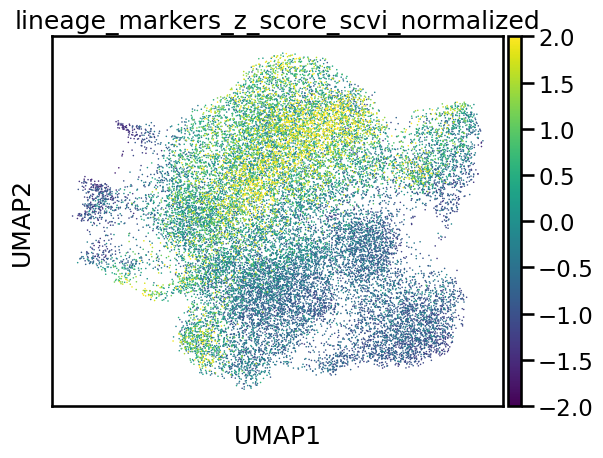

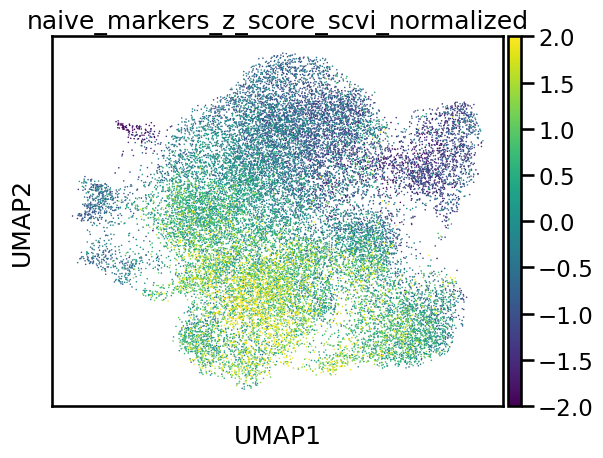

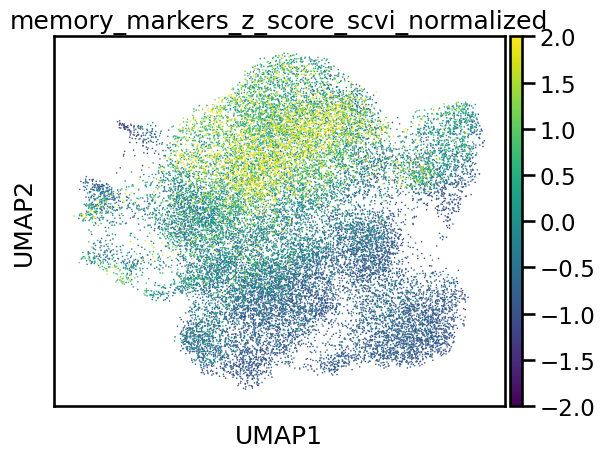

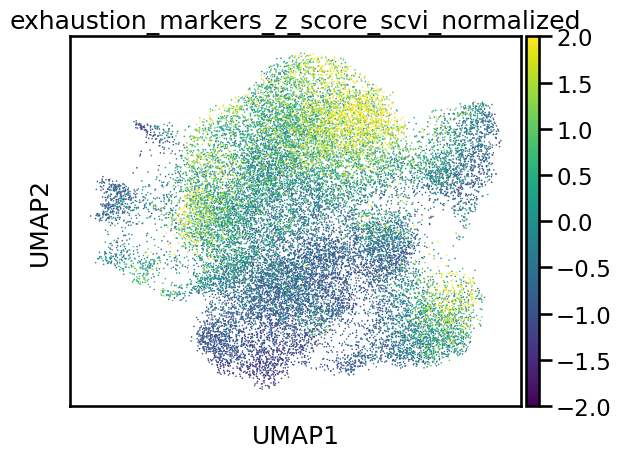

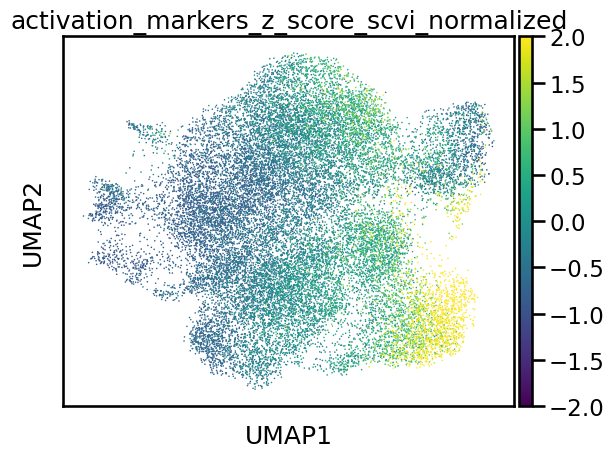

...

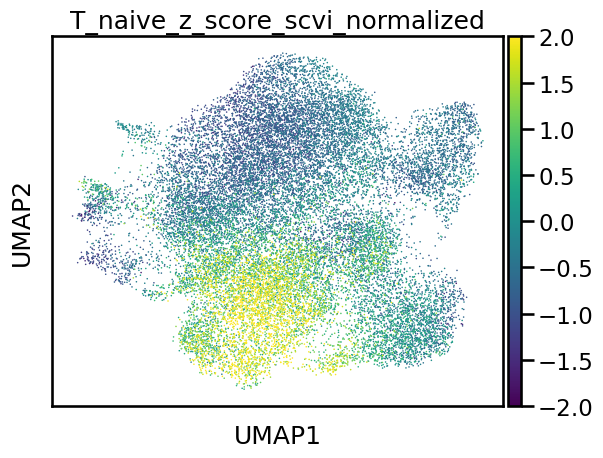

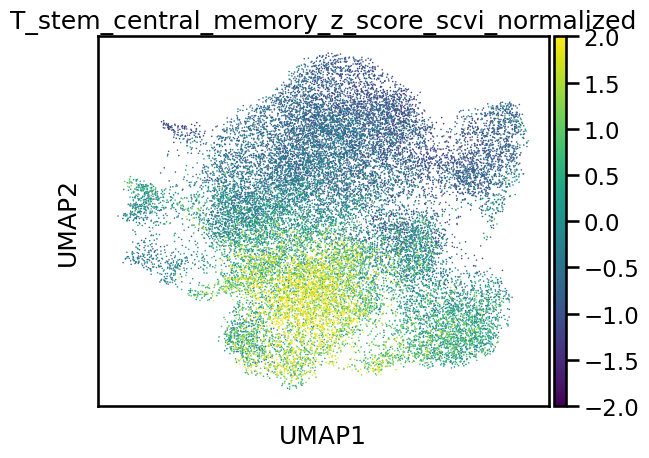

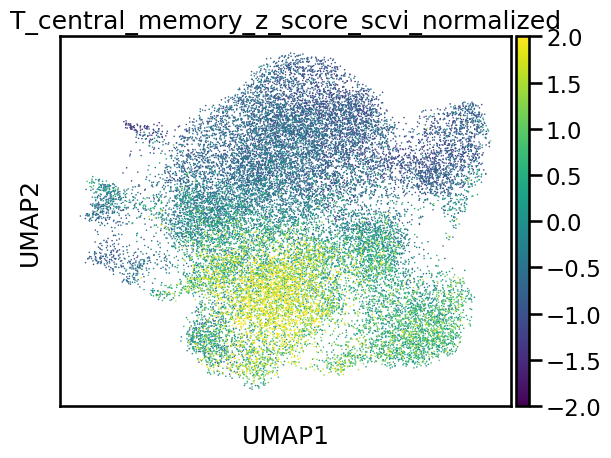

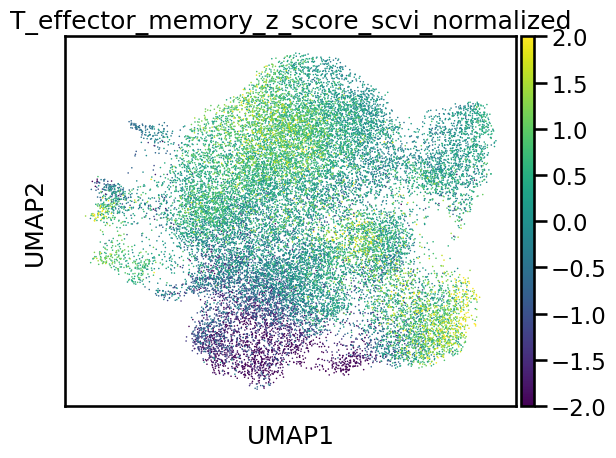

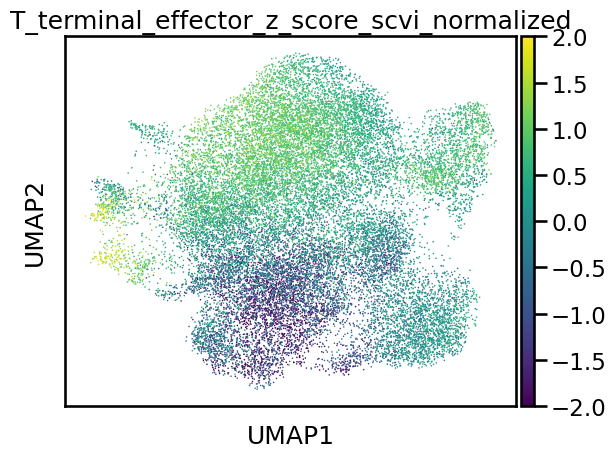

In [ ]:
# calculate mean expression for each gene set and visualize    
for key in marker_genes.keys():
    # handle signed signatures with alternative function
    if key in ['T_naive','T_stem_central_memory','T_central_memory','T_effector_memory','T_terminal_effector']:
        calculate_mean_expression_signed(tcells_scvi, marker_genes, key, layer='scvi_normalized')
        calculate_mean_expression_signed(tcells_scvi, marker_genes, key, layer=None) # unintegrated counts
    else:
        calculate_mean_expression(tcells_scvi, marker_genes, key, layer='scvi_normalized')
        calculate_mean_expression(tcells_scvi, marker_genes, key, layer=None) # unintegrated counts

# plot scvi_normalized counts first
print("plotting scvi_normalized counts:")
marker_genes_expression_set = [s + "_mean_expression_scvi_normalized" for s in marker_genes.keys()]
marker_genes_z_score_set = [s + "_z_score_scvi_normalized" for s in marker_genes.keys()]
for i in range(len(marker_genes_expression_set)):
    # sc.pl.umap(tcells_scvi,color=marker_genes_expression_set[i])#, title = key + " (scVI latent space)")
    sc.pl.umap(tcells_scvi,color=marker_genes_z_score_set[i], 
               # title = key + " (scVI latent space)")
               vmin = -2, vmax = 2,
              )

scVI normalized counts


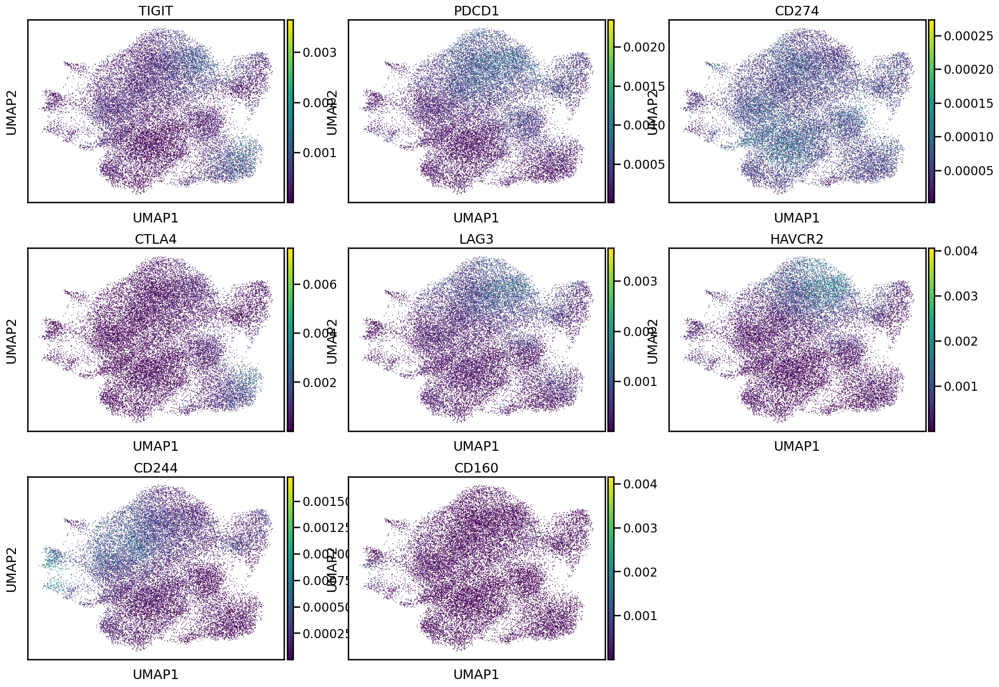

In [24]:
# other_genes_of_interest = ["TOX", "FOXP3", "TCF7", "CD8A", "CD8B", "CD4", "CD3E", "NCAM1"]
other_genes_of_interest = ["TIGIT", "PDCD1", "CD274", "CTLA4", "LAG3", "HAVCR2", "CD244", 
                           "CD160"] # PDCD1 = PD-1, CD274 = PD-L1, HAVCR2 = TIM3
# other_genes_of_interest = ['IL2RA', 'IFNG', 'CD40LG', 'TNFRSF4', 'TNFRSF18', 'CCL5', 'GZMB', 'GZMH', 'ZNF683',]

# print("norm/log counts")
# sc.pl.umap(tcells_scvi, color=other_genes_of_interest, ncols=3)
print("scVI normalized counts")
sc.pl.umap(tcells_scvi, color=other_genes_of_interest, ncols=3, layer="scvi_normalized")

In [22]:
tcells_scvi.write("tcells_scvi_umap_030823.h5ad") #, compression="gzip") # save scVI output anndata file